In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn as skl

In [2]:
data_encoded =pd.read_csv('data_encoded.csv')
data_encoded.head()

,machineID,datetime,volt_min_3h,rotate_min_3h,pressure_min_3h,vibration_min_3h,volt_max_3h,rotate_max_3h,pressure_max_3h,vibration_max_3h,...,comp3,comp4,age,model_model3,model_model4,failure_comp1,failure_comp2,failure_comp4,failure_none,failure_yes
0,1,2015-01-02 06:00:00,158.271400,403.235951,92.439132,32.516838,200.872430,495.777958,96.535487,52.355876,...,155.000,170.000,18,1,0,0,0,0,1,0
1,1,2015-01-02 09:00:00,160.528861,384.645962,86.944273,29.527665,197.363124,486.459056,114.342061,42.992509,...,155.125,170.125,18,1,0,0,0,0,1,0
2,1,2015-01-02 12:00:00,147.300678,412.965696,90.711354,34.203042,173.394523,439.579460,110.408985,37.117103,...,155.250,170.250,18,1,0,0,0,0,1,0
3,1,2015-01-02 15:00:00,152.420775,385.354924,99.506819,30.665184,185.205355,497.840620,105.993247,47.862484,...,155.375,170.375,18,1,0,0,0,0,1,0
4,1,2015-01-02 18:00:00,145.248486,424.542633,93.743827,37.422272,180.030715,495.376449,111.950587,43.099758,...,155.500,170.500,18,1,0,0,0,0,1,0


# Time Series

3H-24H Min-Mean-Max for Machines With Error Points

C:\Users\kerim\AppData\Local\Temp\ipykernel_15068\3009355937.py:38: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
C:\Users\kerim\AppData\Local\Temp\ipykernel_15068\3009355937.py:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],


<Figure size 48000x240000 with 0 Axes>

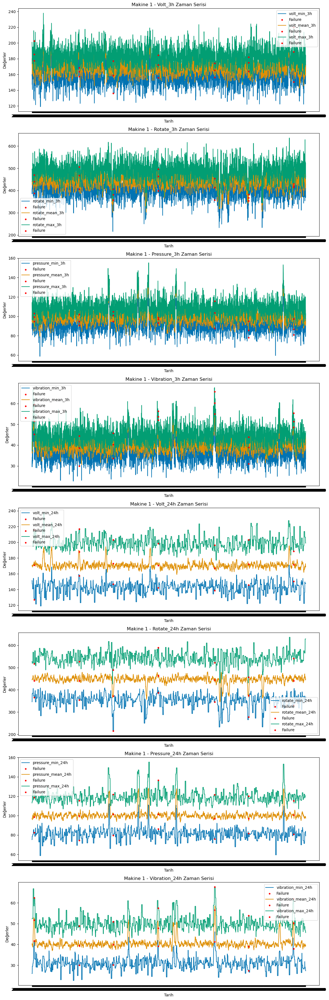

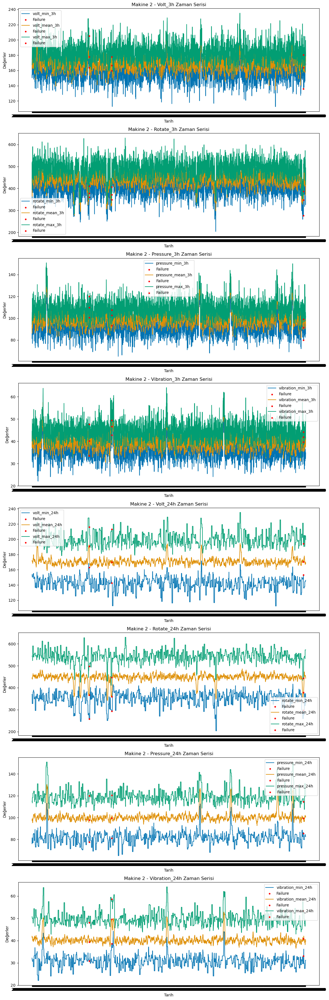

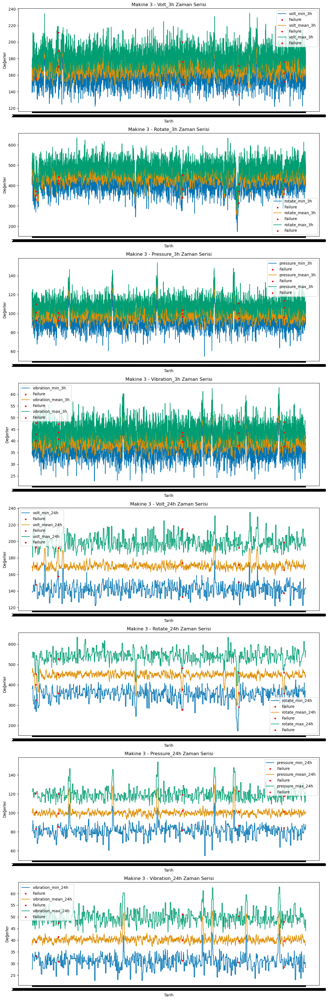

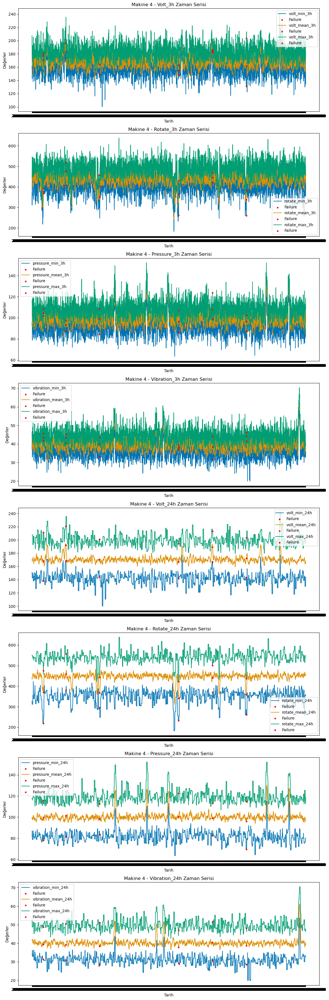

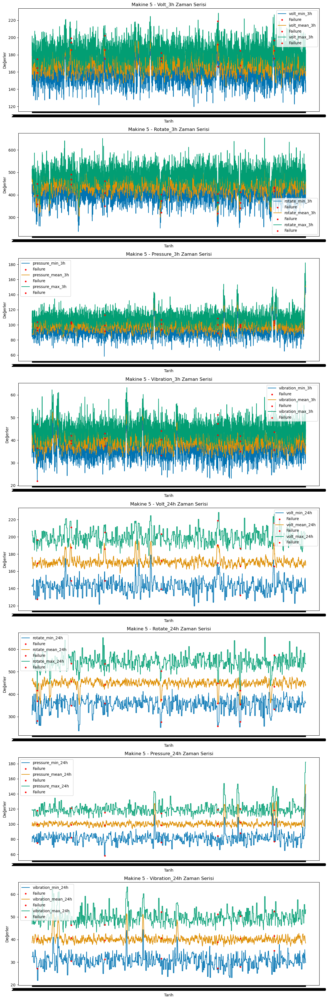

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

# Seaborn'un colorblind paletini kullanmak için ayarla
sns.set_palette("colorblind")

# Seçilen makinelerin listesi
selected_machine_ids = [1, 2, 3, 4, 5]

# Özelliklerin listesi (voltaj, dönüş, basınç, titreşim için hem 3 saatlik hem de 24 saatlik sütunlar)
features = {
    'volt_3h': ['volt_min_3h', 'volt_mean_3h', 'volt_max_3h'],
    'rotate_3h': ['rotate_min_3h', 'rotate_mean_3h', 'rotate_max_3h'],
    'pressure_3h': ['pressure_min_3h', 'pressure_mean_3h', 'pressure_max_3h'],
    'vibration_3h': ['vibration_min_3h', 'vibration_mean_3h', 'vibration_max_3h'],
    'volt_24h': ['volt_min_24h', 'volt_mean_24h', 'volt_max_24h'],
    'rotate_24h': ['rotate_min_24h', 'rotate_mean_24h', 'rotate_max_24h'],
    'pressure_24h': ['pressure_min_24h', 'pressure_mean_24h', 'pressure_max_24h'],
    'vibration_24h': ['vibration_min_24h', 'vibration_mean_24h', 'vibration_max_24h']
}

# Her makine için ayrı grafikler oluşturun
plt.figure(figsize=(480, 2400))

for machine_id in selected_machine_ids:
    plt.figure(figsize=(12, 36))

    for index, (key, value) in enumerate(features.items()):
        plt.subplot(len(features), 1, index + 1)

        for feature in value:
            # Özelliklerin zaman serilerini çiz
            plt.plot(data_encoded[data_encoded['machineID'] == machine_id]['datetime'],
                     data_encoded[data_encoded['machineID'] == machine_id][feature],
                     label=feature)

            # failure_yes sütununu scatter plot olarak çiz, failure_yes == 1 olduğunda belirgin renk
            plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
                        data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],
                        color='red', label='Failure', zorder=5,s=10)

        plt.xlabel('Tarih')
        plt.ylabel('Değerler')
        plt.title(f'Makine {machine_id} - {key.capitalize()} Zaman Serisi')
        plt.legend()

    plt.tight_layout()
    plt.savefig(f'makine_{machine_id}_grafik.png')

    plt.show()


In [ ]:
#alternative
# Seçilen makinelerin listesi
selected_machine_ids = [1, 2, 3, 4, 5]

# Özelliklerin listesi (voltaj, dönüş, basınç, titreşim için hem 3 saatlik hem de 24 saatlik sütunlar)
features = {
    'volt_3h': ['volt_min_3h', 'volt_mean_3h', 'volt_max_3h'],
    'rotate_3h': ['rotate_min_3h', 'rotate_mean_3h', 'rotate_max_3h'],
    'pressure_3h': ['pressure_min_3h', 'pressure_mean_3h', 'pressure_max_3h'],
    'vibration_3h': ['vibration_min_3h', 'vibration_mean_3h', 'vibration_max_3h'],
    'volt_24h': ['volt_min_24h', 'volt_mean_24h', 'volt_max_24h'],
    'rotate_24h': ['rotate_min_24h', 'rotate_mean_24h', 'rotate_max_24h'],
    'pressure_24h': ['pressure_min_24h', 'pressure_mean_24h', 'pressure_max_24h'],
    'vibration_24h': ['vibration_min_24h', 'vibration_mean_24h', 'vibration_max_24h']
}

# Her makine için ve her özellik için ayrı ayrı subplotlar oluşturun
plt.figure(figsize=(12, 180))  # Geniş bir figür oluştur

subplot_index = 1
for machine_id in selected_machine_ids:
    for key, value in features.items():
        plt.subplot(len(selected_machine_ids) * len(features), 1, subplot_index)

        for feature in value:
            plt.plot(data_encoded[data_encoded['machineID'] == machine_id]['datetime'],
                     data_encoded[data_encoded['machineID'] == machine_id][feature],
                     label=feature)
            
            # failure_yes sütununu scatter plot olarak çiz, failure_yes == 1 olduğunda belirgin renk
            plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
                        data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],
                        color='red', label='Failure', zorder=5,s=10)

        plt.xlabel('Tarih')
        plt.ylabel('Değerler')
        plt.title(f'Makine {machine_id} - {key.capitalize()} Zaman Serisi')
        plt.legend()

        subplot_index += 1

plt.tight_layout()
plt.savefig('Zaman_serisi_analizleri_hepsi.png')
plt.show()

Means & SDs (3h+24h) For Machines with error points

C:\Users\kerim\AppData\Local\Temp\ipykernel_15068\3100622810.py:32: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
C:\Users\kerim\AppData\Local\Temp\ipykernel_15068\3100622810.py:33: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],


<Figure size 1600x18000 with 0 Axes>

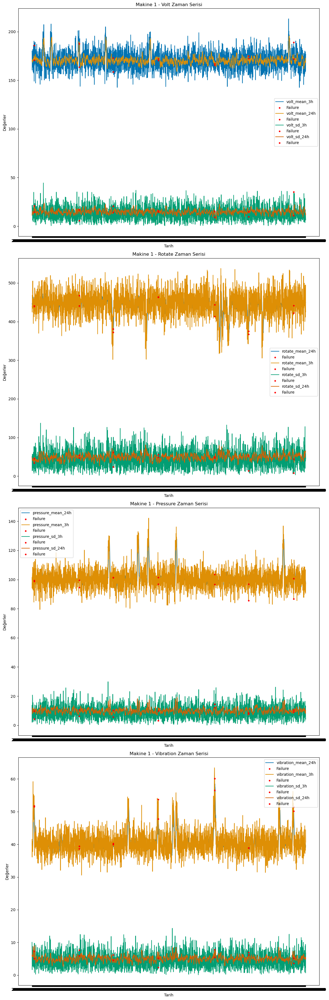

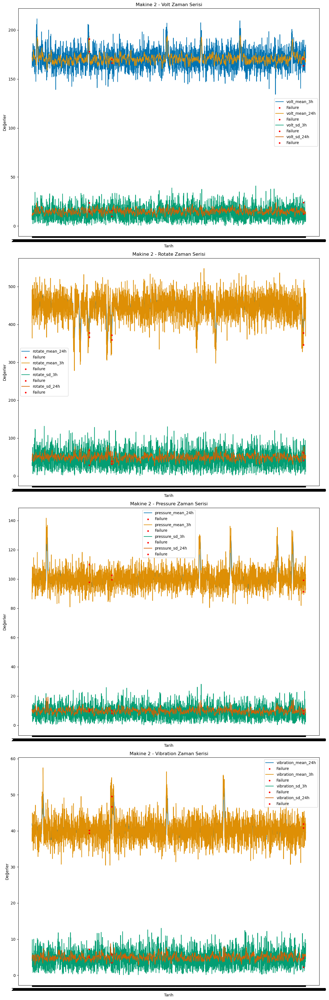

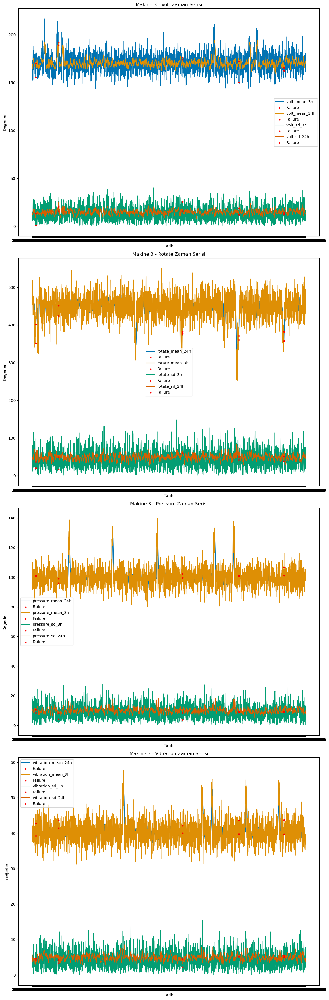

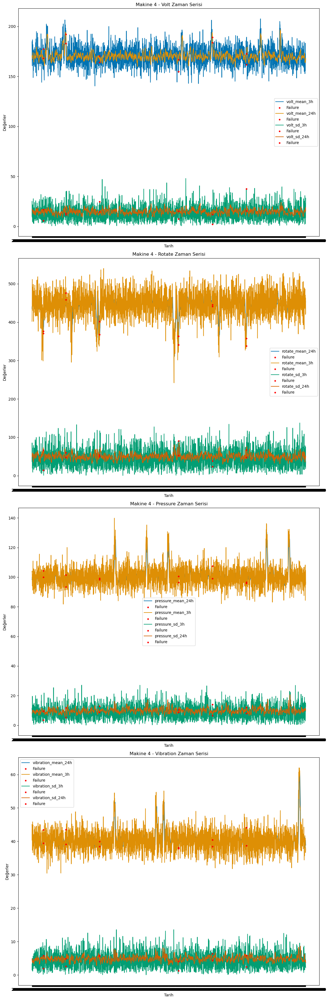

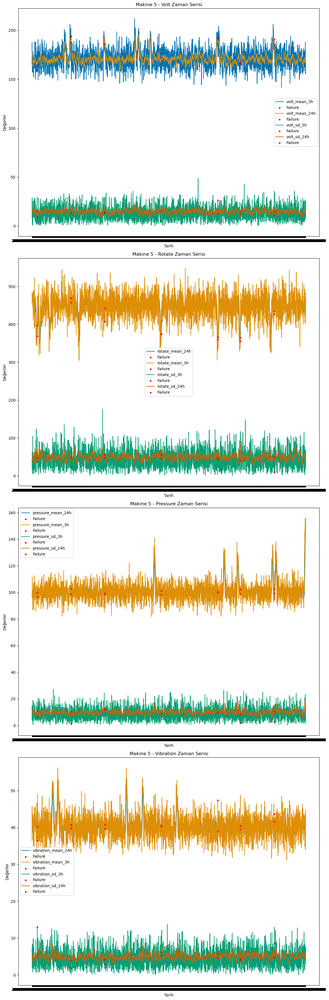

In [4]:
# Seaborn'un colorblind paletini kullanmak için ayarla
sns.set_palette("colorblind")

# Seçilen makinelerin listesi
selected_machine_ids = [1, 2, 3, 4, 5]

# Özelliklerin listesi (voltaj, dönüş, basınç, titreşim için hem 3 saatlik hem de 24 saatlik sütunlar)
features = {
    'volt': ['volt_mean_3h','volt_mean_24h', 'volt_sd_3h', 'volt_sd_24h'],
    'rotate': ['rotate_mean_24h', 'rotate_mean_3h', 'rotate_sd_3h','rotate_sd_24h'],
    'pressure': ['pressure_mean_24h', 'pressure_mean_3h', 'pressure_sd_3h', 'pressure_sd_24h'],
    'vibration': ['vibration_mean_24h', 'vibration_mean_3h', 'vibration_sd_3h', 'vibration_sd_24h']
}


# Her makine için ayrı grafikler oluşturun
plt.figure(figsize=(16, 180))

for machine_id in selected_machine_ids:
    plt.figure(figsize=(12, 36))

    for index, (key, value) in enumerate(features.items()):
        plt.subplot(len(features), 1, index + 1)

        for feature in value:
            # Özelliklerin zaman serilerini çiz
            plt.plot(data_encoded[data_encoded['machineID'] == machine_id]['datetime'],
                     data_encoded[data_encoded['machineID'] == machine_id][feature],
                     label=feature)

            # failure_yes sütununu scatter plot olarak çiz, failure_yes == 1 olduğunda belirgin renk
            plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
                        data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],
                        color='red', label='Failure', zorder=5,s=10)

        plt.xlabel('Tarih')
        plt.ylabel('Değerler')
        plt.title(f'Makine {machine_id} - {key.capitalize()} Zaman Serisi')
        plt.legend()

    plt.tight_layout()

    plt.show()

Means + SDs (3h+24h) For Machines with error points (Detailed)

C:\Users\kerim\AppData\Local\Temp\ipykernel_15068\2153278353.py:35: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
C:\Users\kerim\AppData\Local\Temp\ipykernel_15068\2153278353.py:36: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],


<Figure size 1600x18000 with 0 Axes>

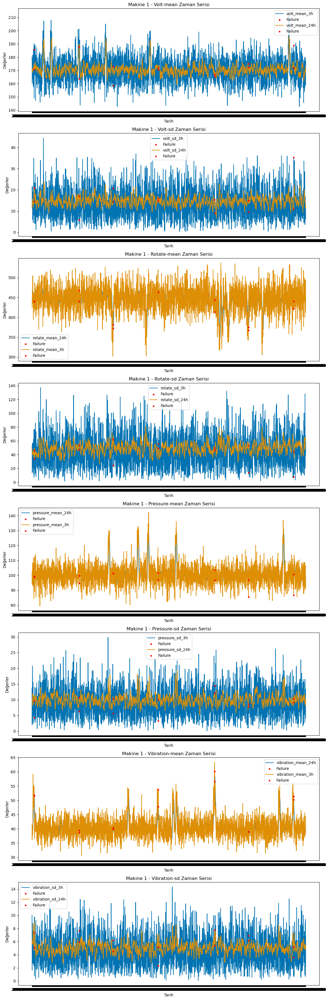

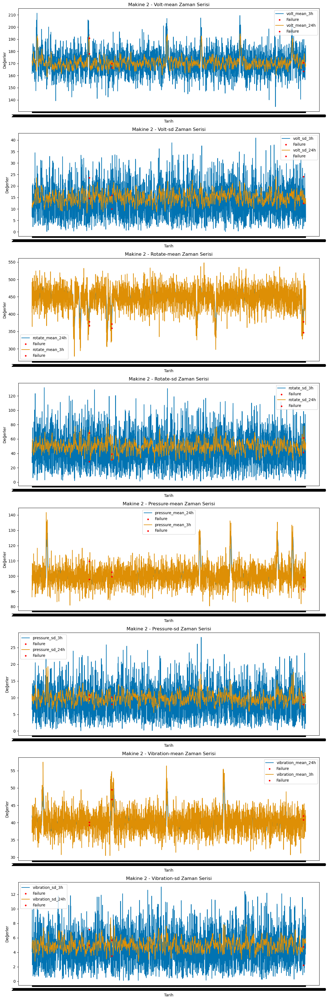

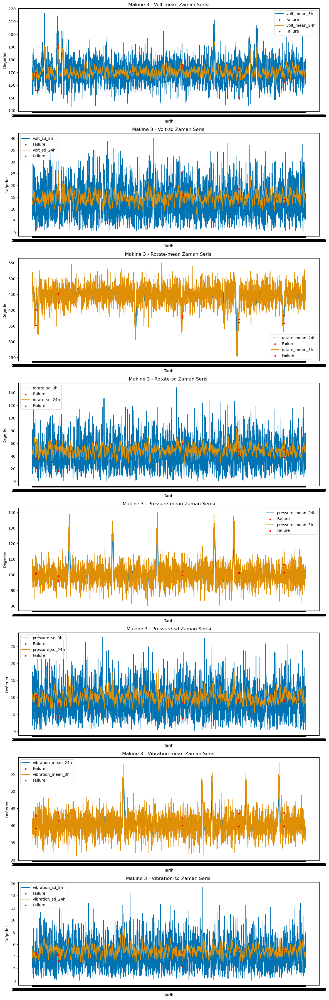

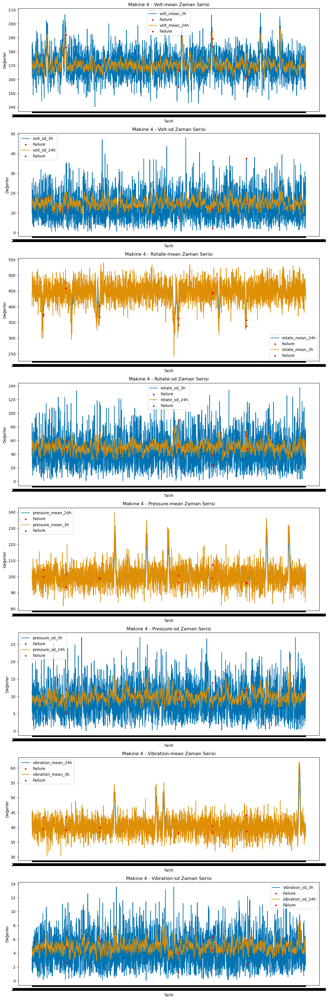

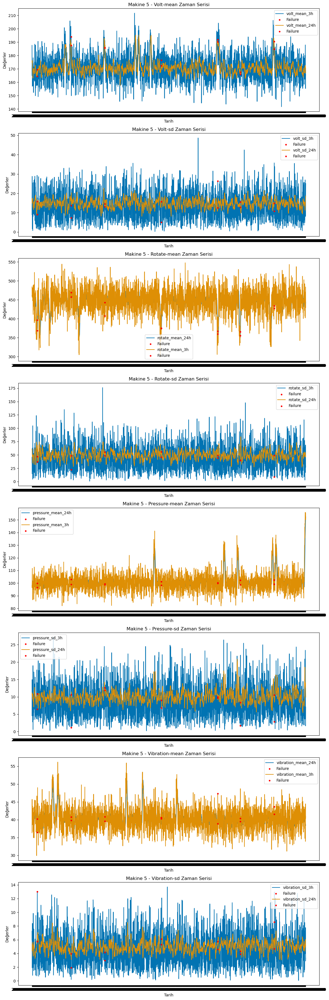

In [5]:

sns.set_palette("colorblind")

# Seçilen makinelerin listesi
selected_machine_ids = [1, 2, 3, 4, 5]

# Özelliklerin listesi (voltaj, dönüş, basınç, titreşim için hem 3 saatlik hem de 24 saatlik sütunlar)
features = {
    'volt-mean': ['volt_mean_3h','volt_mean_24h'],
    'volt-sd': [ 'volt_sd_3h', 'volt_sd_24h'],
    'rotate-mean': ['rotate_mean_24h', 'rotate_mean_3h'],
    'rotate-sd': [ 'rotate_sd_3h','rotate_sd_24h'],
    'pressure-mean': ['pressure_mean_24h', 'pressure_mean_3h'],
    'pressure-sd': [ 'pressure_sd_3h', 'pressure_sd_24h'],
    'vibration-mean': ['vibration_mean_24h', 'vibration_mean_3h'],
    'vibration-sd': [ 'vibration_sd_3h', 'vibration_sd_24h']
}


# Her makine için ayrı grafikler oluşturun
plt.figure(figsize=(16, 180))

for machine_id in selected_machine_ids:
    plt.figure(figsize=(12, 36))

    for index, (key, value) in enumerate(features.items()):
        plt.subplot(len(features), 1, index + 1)

        for feature in value:
            # Özelliklerin zaman serilerini çiz
            plt.plot(data_encoded[data_encoded['machineID'] == machine_id]['datetime'],
                     data_encoded[data_encoded['machineID'] == machine_id][feature],
                     label=feature)

            # failure_yes sütununu scatter plot olarak çiz, failure_yes == 1 olduğunda belirgin renk
            plt.scatter(data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1]['datetime'],
                        data_encoded[data_encoded['machineID'] == machine_id][data_encoded['failure_yes'] == 1][feature],
                        color='red', label='Failure', zorder=5,s=10)

        plt.xlabel('Tarih')
        plt.ylabel('Değerler')
        plt.title(f'Makine {machine_id} - {key.capitalize()} Zaman Serisi')
        plt.legend()

    plt.tight_layout()

    plt.show()

Machines SD (3h+24h) + Means(3h+24h) 

# Feature Engineering:

1 Haftalık Lag

C:\Users\kerim\anaconda3\Lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


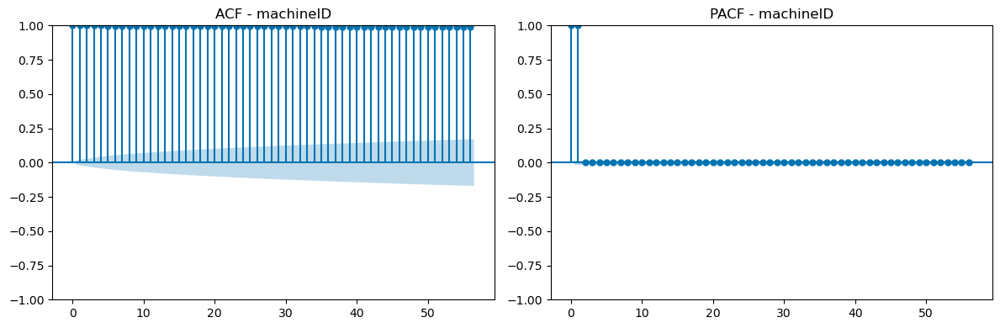

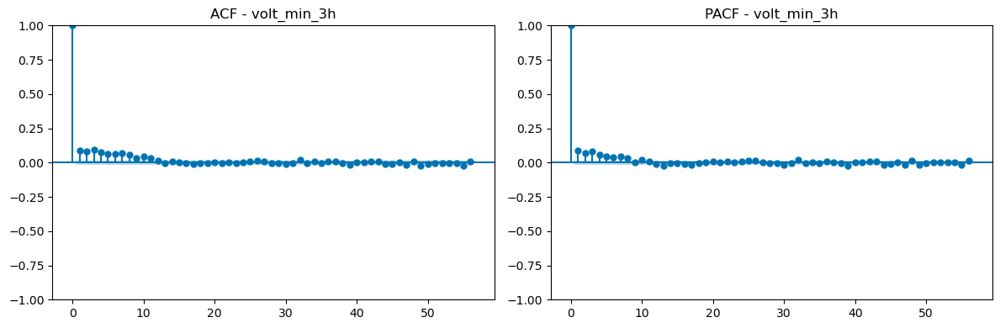

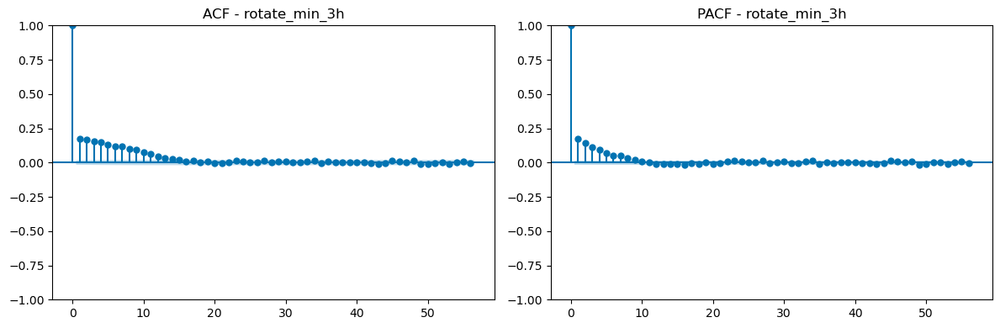

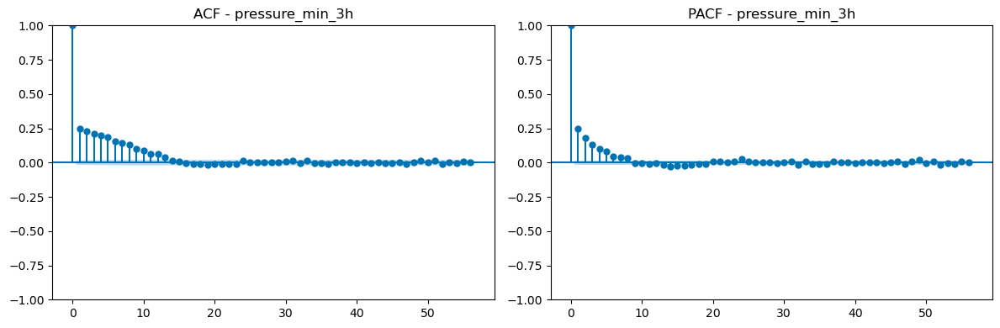

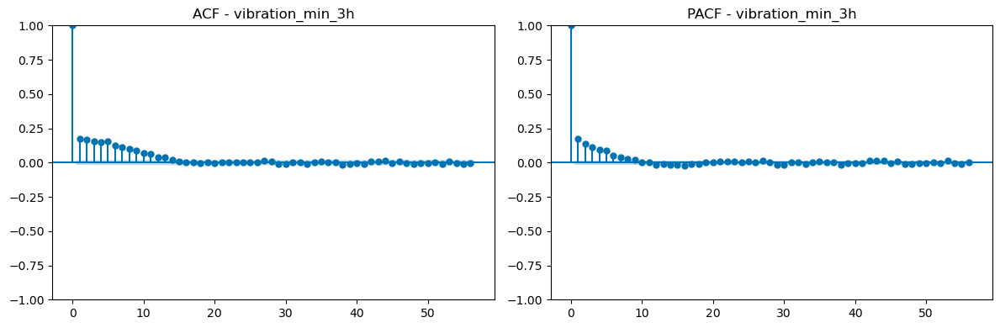

...

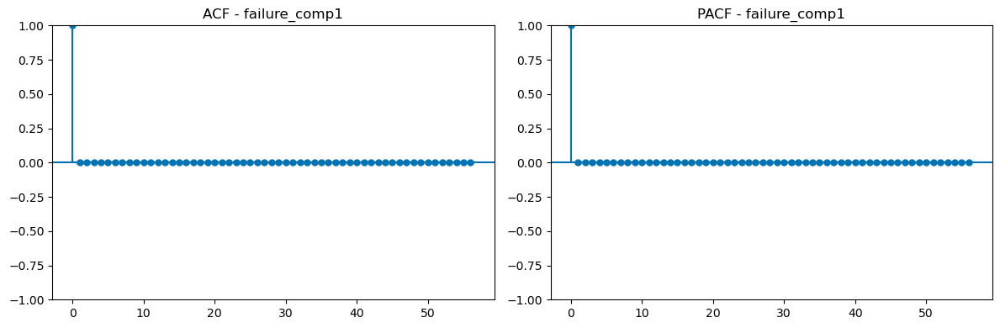

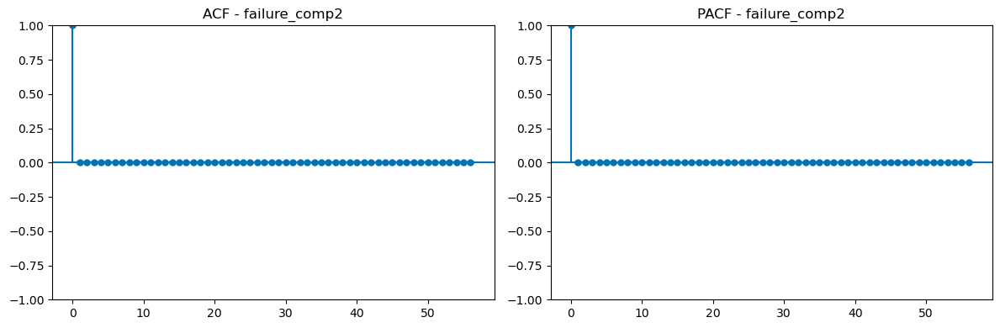

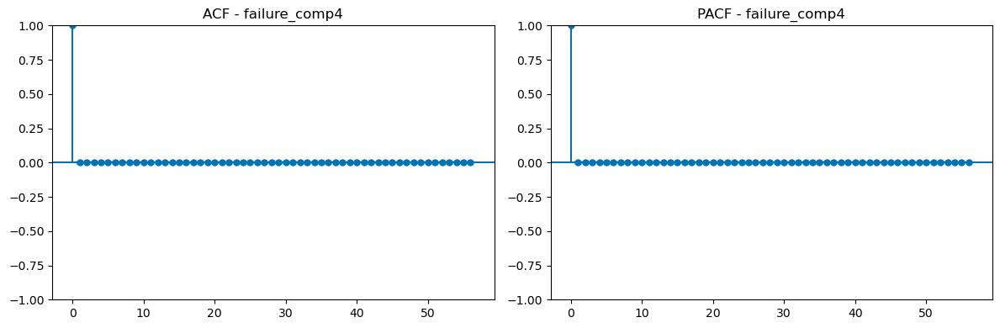

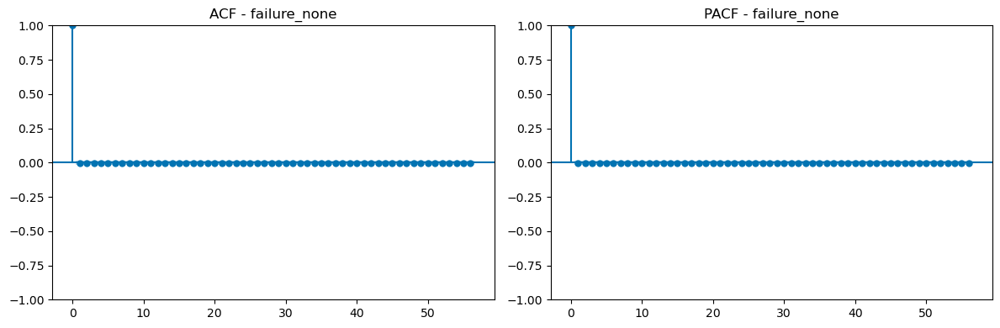

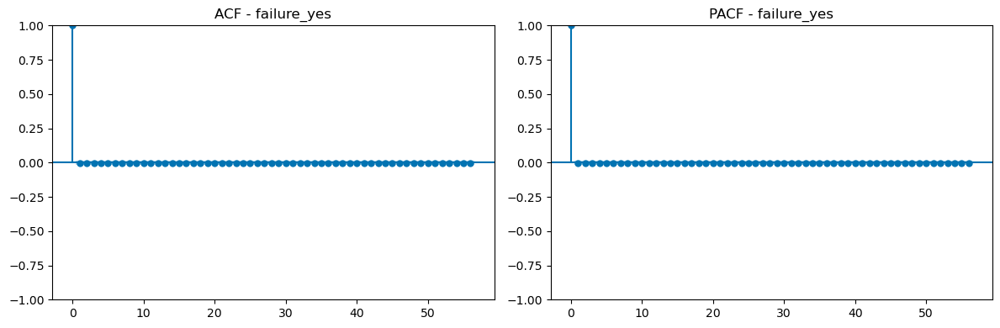

In [7]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

# ACF ve PACF grafiklerini çizme fonksiyonu
def plot_acf_pacf(series, title):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    plot_acf(series, ax=ax1, lags=56)
    ax1.set_title(f'ACF - {title}')
    plot_pacf(series, ax=ax2, lags=56)
    ax2.set_title(f'PACF - {title}')
    plt.tight_layout()
    plt.show()

# Tüm sayısal özellikler için ACF ve PACF grafiklerini çizme
numeric_columns = data_encoded.select_dtypes(include=[np.number]).columns

for column in numeric_columns:
    plot_acf_pacf(data_encoded[column], column)


2 Günlük Lag

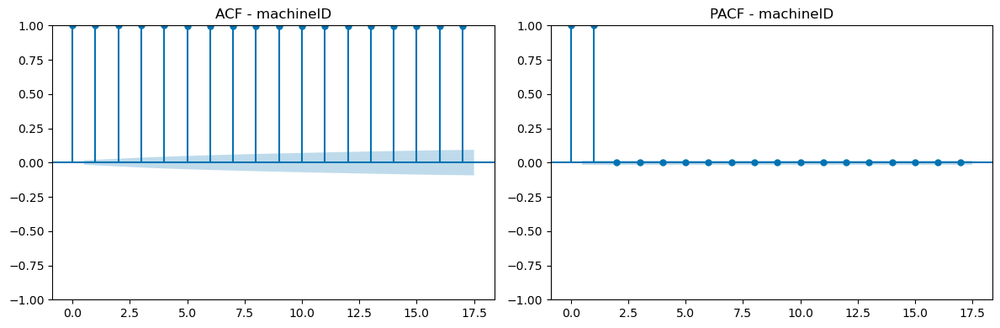

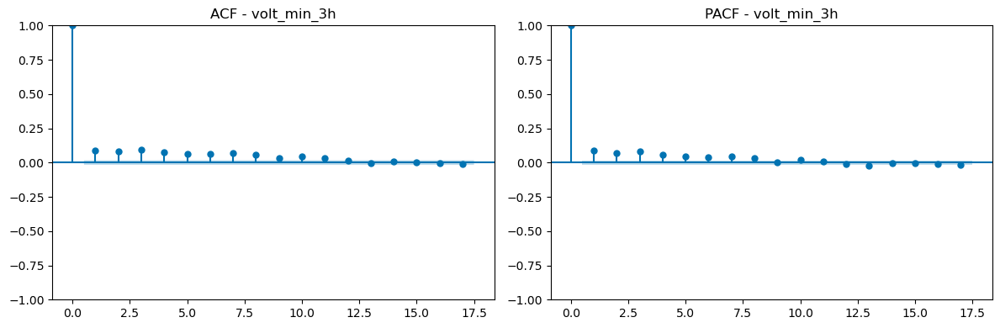

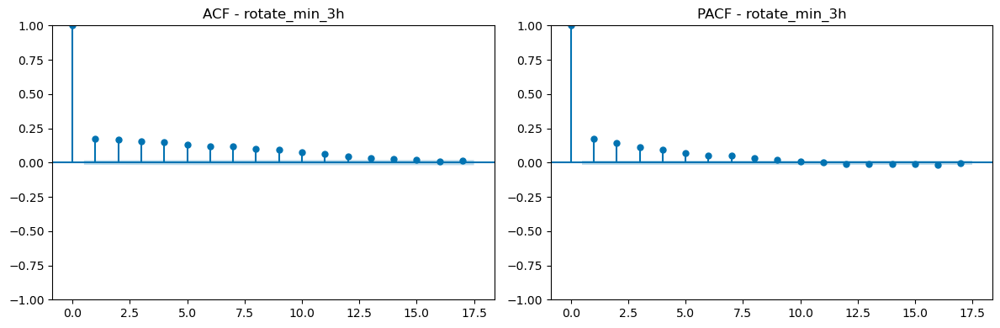

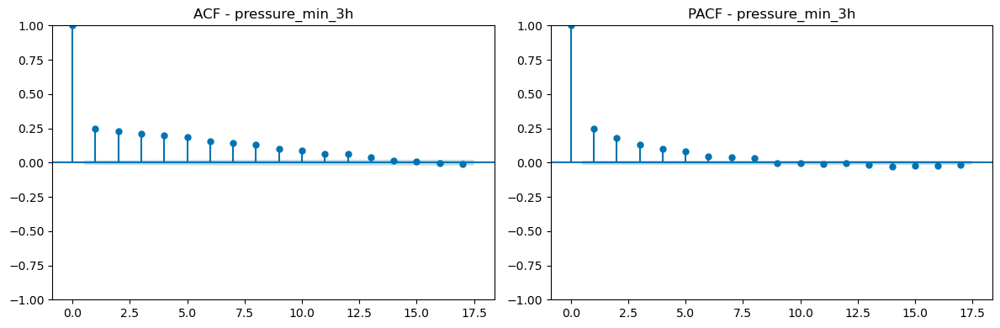

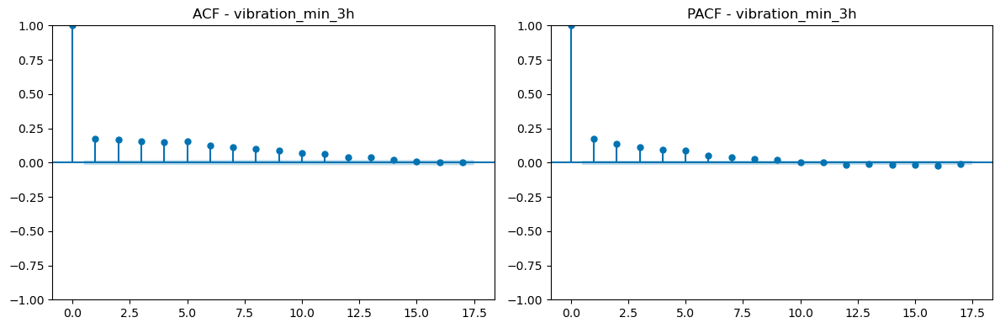

...

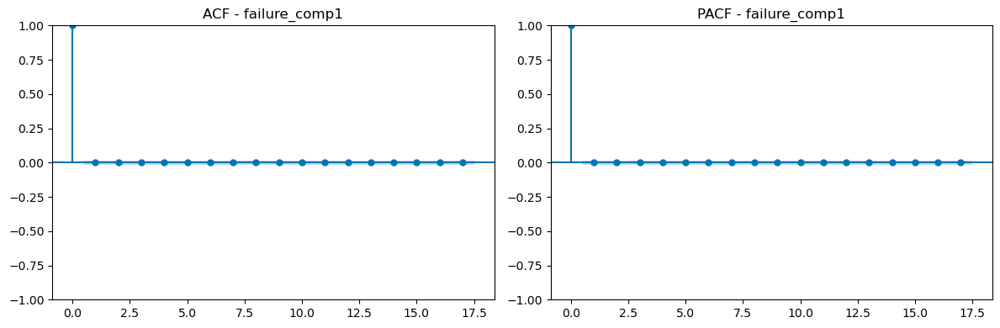

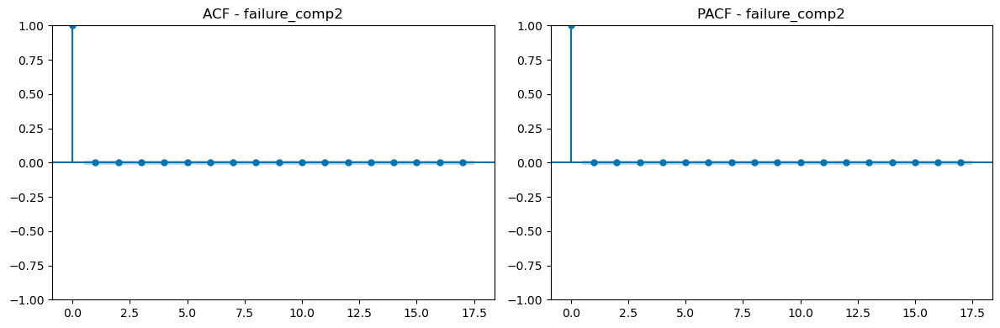

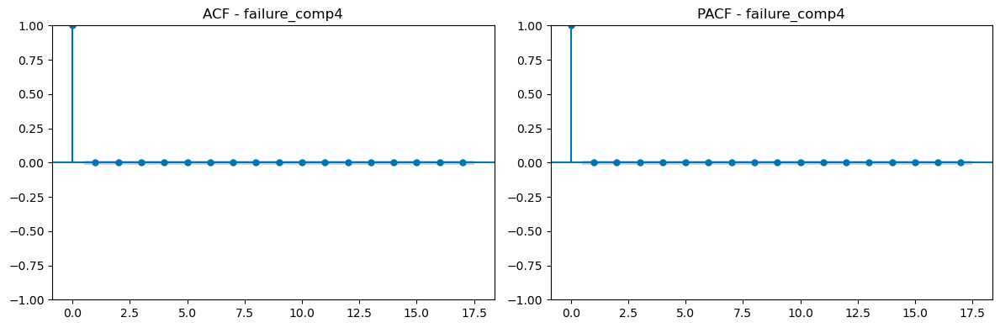

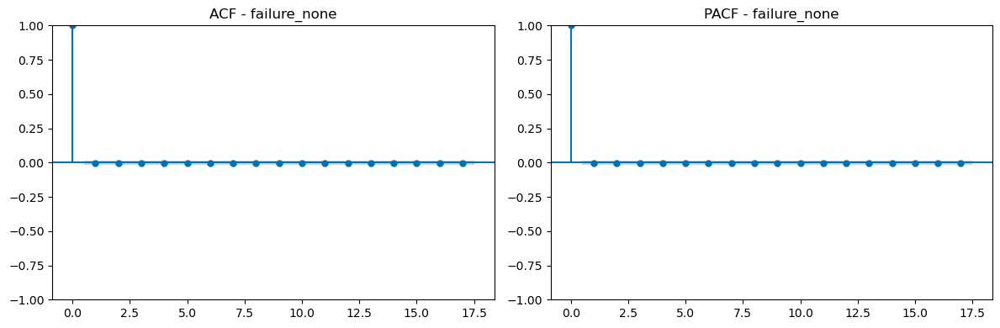

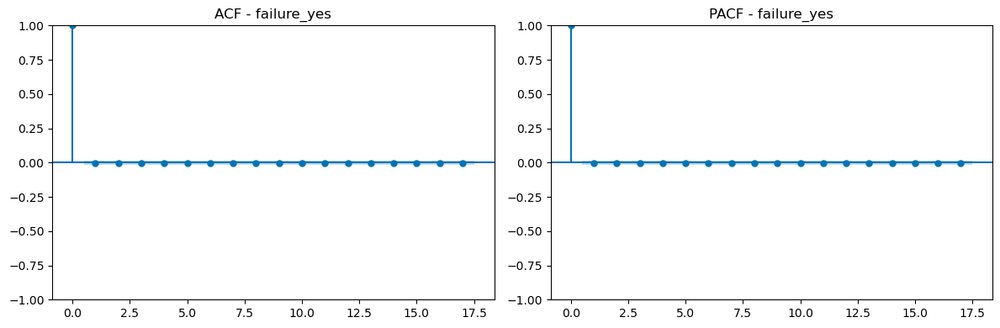

In [8]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

# ACF ve PACF grafiklerini çizme fonksiyonu
def plot_acf_pacf(series, title):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    plot_acf(series, ax=ax1, lags=17)
    ax1.set_title(f'ACF - {title}')
    plot_pacf(series, ax=ax2, lags=17)
    ax2.set_title(f'PACF - {title}')
    plt.tight_layout()
    plt.show()

# Tüm sayısal özellikler için ACF ve PACF grafiklerini çizme
numeric_columns = data_encoded.select_dtypes(include=[np.number]).columns

for column in numeric_columns:
    plot_acf_pacf(data_encoded[column], column)


1 Günlük Lag

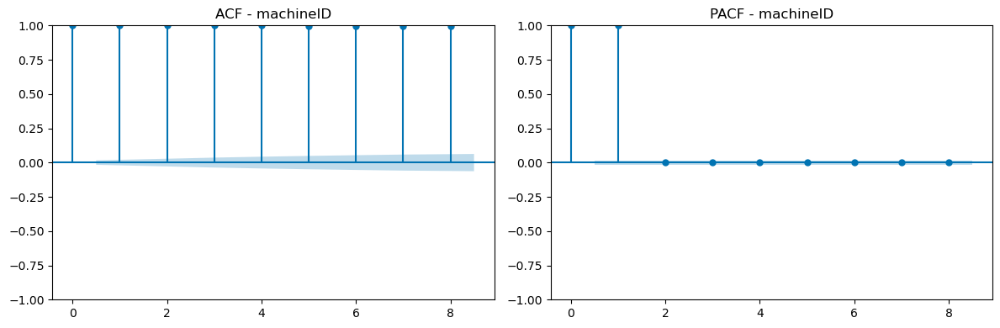

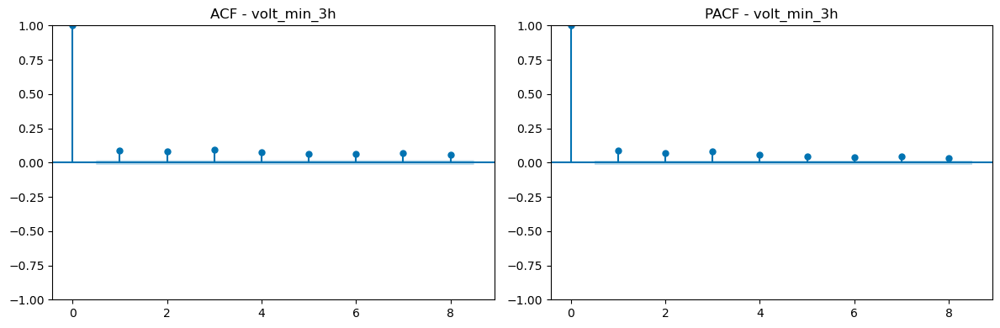

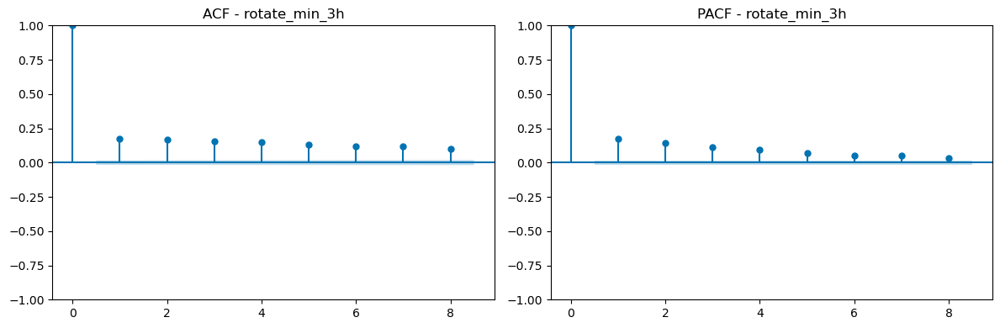

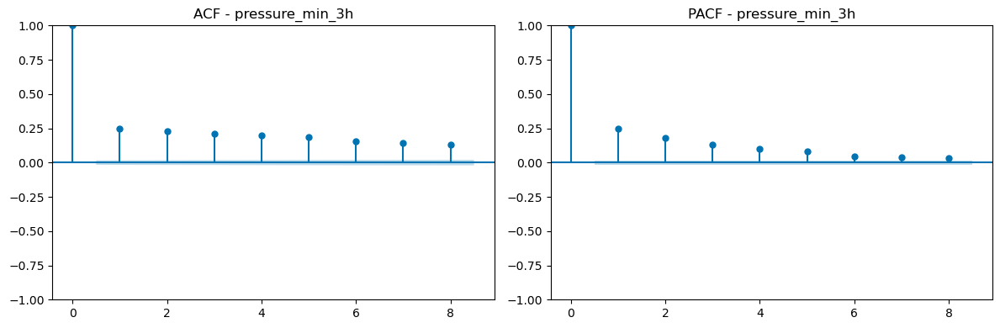

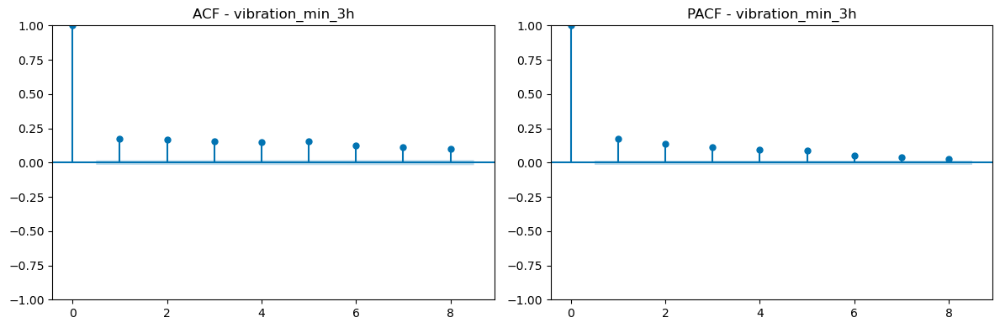

...

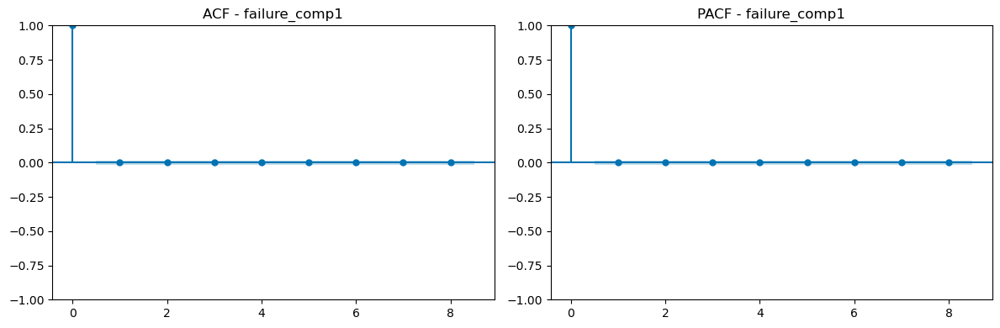

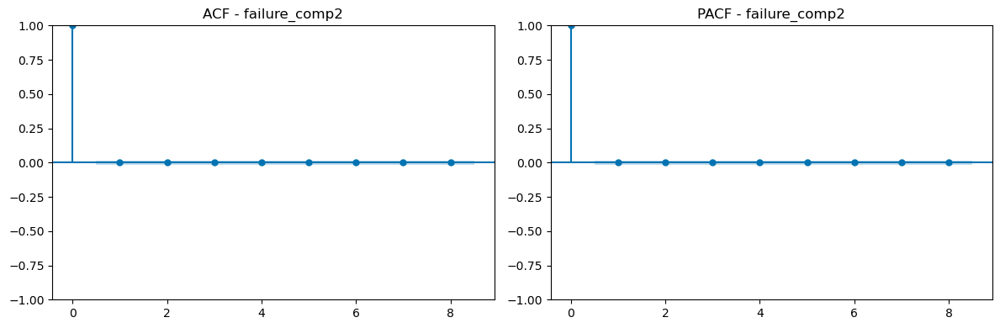

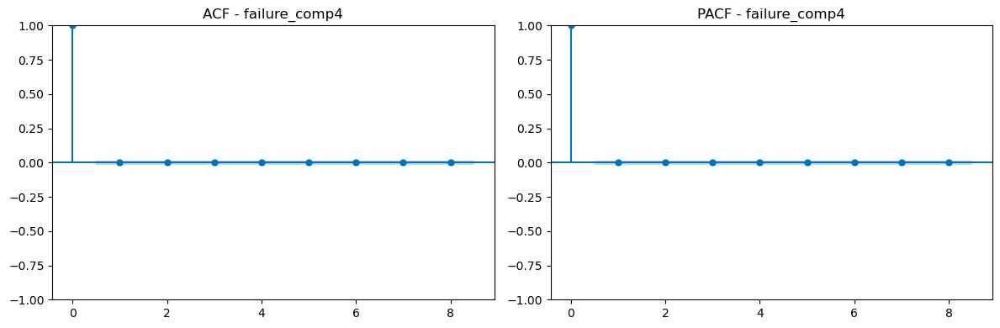

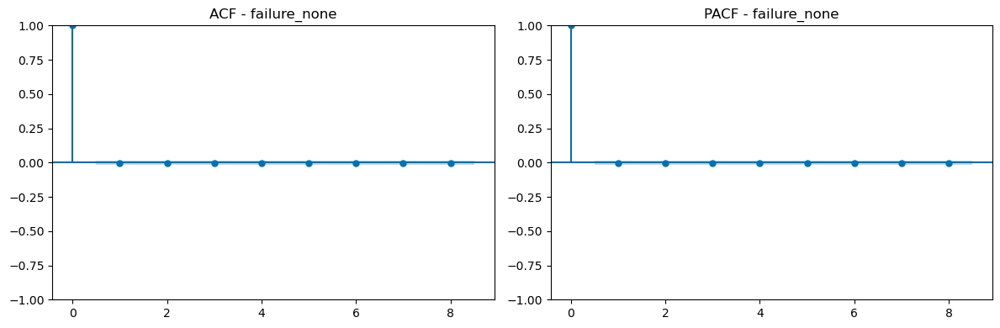

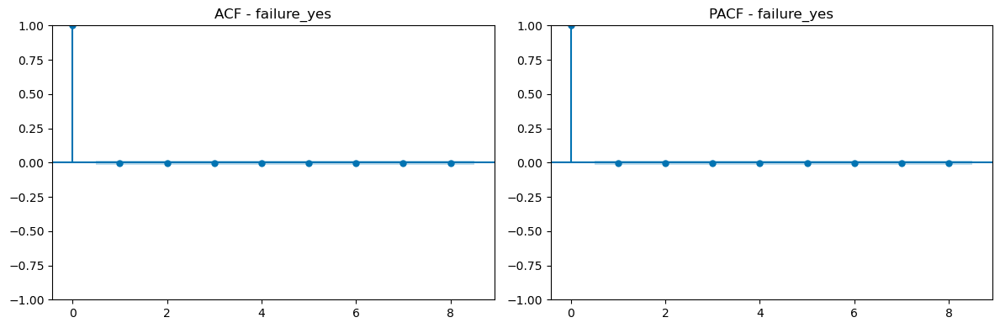

In [9]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

# ACF ve PACF grafiklerini çizme fonksiyonu
def plot_acf_pacf(series, title):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    plot_acf(series, ax=ax1, lags=8)
    ax1.set_title(f'ACF - {title}')
    plot_pacf(series, ax=ax2, lags=8)
    ax2.set_title(f'PACF - {title}')
    plt.tight_layout()
    plt.show()

# Tüm sayısal özellikler için ACF ve PACF grafiklerini çizme
numeric_columns = data_encoded.select_dtypes(include=[np.number]).columns

for column in numeric_columns:
    plot_acf_pacf(data_encoded[column], column)


In [10]:
data_en_fe = data_encoded.copy()

In [11]:
# Lag sütunları oluşturma
columns_to_lag = [
    'vibration_max_3h',
    'rotate_mean_3h',
    'pressure_min_3h',
    'pressure_max_3h',
    'pressure_mean_3h',
    'vibration_mean_3h'
]

# Her machineID grubu için lag sütunlarını oluşturma
for col in columns_to_lag:
    for lag in [1, 2, 4]:
        lag_col_name = f'{col}_lag{lag}'
        data_en_fe[lag_col_name] = data_en_fe.groupby('machineID')[col].shift(lag)
        
        # NaN değerlerini orijinal sütundaki değerlerle doldurma
        data_en_fe[lag_col_name].fillna(data_en_fe[col], inplace=True)

# Kopyalama işleminin başarılı olup olmadığını kontrol etmek için ilk birkaç satırı görüntüleyin
data_en_fe.head(10)

,machineID,datetime,volt_min_3h,rotate_min_3h,pressure_min_3h,vibration_min_3h,volt_max_3h,rotate_max_3h,pressure_max_3h,vibration_max_3h,...,pressure_min_3h_lag4,pressure_max_3h_lag1,pressure_max_3h_lag2,pressure_max_3h_lag4,pressure_mean_3h_lag1,pressure_mean_3h_lag2,pressure_mean_3h_lag4,vibration_mean_3h_lag1,vibration_mean_3h_lag2,vibration_mean_3h_lag4
0,1,2015-01-02 06:00:00,158.271400,403.235951,92.439132,32.516838,200.872430,495.777958,96.535487,52.355876,...,92.439132,96.535487,96.535487,96.535487,94.137969,94.137969,94.137969,41.551544,41.551544,41.551544
1,1,2015-01-02 09:00:00,160.528861,384.645962,86.944273,29.527665,197.363124,486.459056,114.342061,42.992509,...,86.944273,96.535487,114.342061,114.342061,94.137969,101.553209,101.553209,41.551544,36.105580,36.105580
2,1,2015-01-02 12:00:00,147.300678,412.965696,90.711354,34.203042,173.394523,439.579460,110.408985,37.117103,...,90.711354,114.342061,96.535487,110.408985,101.553209,94.137969,99.598722,36.105580,41.551544,36.094637
3,1,2015-01-02 15:00:00,152.420775,385.354924,99.506819,30.665184,185.205355,497.840620,105.993247,47.862484,...,99.506819,110.408985,114.342061,105.993247,99.598722,101.553209,102.380586,36.094637,36.105580,40.483002
4,1,2015-01-02 18:00:00,145.248486,424.542633,93.743827,37.422272,180.030715,495.376449,111.950587,43.099758,...,92.439132,105.993247,110.408985,96.535487,102.380586,99.598722,94.137969,40.483002,36.094637,41.551544
5,1,2015-01-02 21:00:00,140.776309,414.274295,86.323760,31.279321,183.800863,493.161428,127.014498,45.135194,...,86.944273,111.950587,105.993247,114.342061,102.726648,102.380586,101.553209,40.921802,40.483002,36.105580
6,1,2015-01-03 00:00:00,160.656926,418.069791,80.668287,35.944564,190.927218,446.613843,115.313312,42.638679,...,90.711354,127.014498,111.950587,110.408985,104.387585,102.726648,99.598722,38.068116,40.921802,36.094637
7,1,2015-01-03 03:00:00,168.373525,489.910898,101.528033,35.468444,179.550116,521.837936,114.042406,41.730698,...,99.506819,115.313312,127.014498,105.993247,93.747282,104.387585,102.380586,39.716482,38.068116,40.483002
8,1,2015-01-03 06:00:00,174.138401,418.842271,91.926306,32.323616,194.942847,510.256976,95.896312,47.163648,...,93.743827,114.042406,115.313312,111.950587,108.512153,93.747282,102.726648,37.763933,39.716482,40.921802
9,1,2015-01-03 09:00:00,164.341435,459.956670,94.488533,47.875804,177.594089,568.972310,104.432962,52.997327,...,86.323760,95.896312,114.042406,127.014498,93.395164,108.512153,104.387585,38.621099,37.763933,38.068116


In [12]:
columns_to_lag = [
    'volt_min_24h', 'volt_max_24h', 'volt_mean_24h', 'volt_sd_24h',
    'vibration_min_24h','vibration_max_24h','vibration_mean_24h','vibration_sd_24h',
    'rotate_min_24h','rotate_max_24h','rotate_mean_24h','rotate_sd_24h',
    'pressure_min_24h','pressure_max_24h','pressure_mean_24h','pressure_sd_24h',
    'error5count', 'error4count', 'error3count','error2count','error1count'
]

# Her machineID grubu için lag sütunlarını oluşturma
for col in columns_to_lag:
    for lag in [1, 8]:
        lag_col_name = f'{col}_lag{lag}'
        data_en_fe[lag_col_name] = data_en_fe.groupby('machineID')[col].shift(lag)
        
        # NaN değerlerini orijinal sütundaki değerlerle doldurma
        data_en_fe[lag_col_name].fillna(data_en_fe[col], inplace=True)

# Kopyalama işleminin başarılı olup olmadığını kontrol etmek için ilk birkaç satırı görüntüleyin
data_en_fe.head(10)

,machineID,datetime,volt_min_3h,rotate_min_3h,pressure_min_3h,vibration_min_3h,volt_max_3h,rotate_max_3h,pressure_max_3h,vibration_max_3h,...,error5count_lag1,error5count_lag8,error4count_lag1,error4count_lag8,error3count_lag1,error3count_lag8,error2count_lag1,error2count_lag8,error1count_lag1,error1count_lag8
0,1,2015-01-02 06:00:00,158.271400,403.235951,92.439132,32.516838,200.872430,495.777958,96.535487,52.355876,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,2015-01-02 09:00:00,160.528861,384.645962,86.944273,29.527665,197.363124,486.459056,114.342061,42.992509,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1,2015-01-02 12:00:00,147.300678,412.965696,90.711354,34.203042,173.394523,439.579460,110.408985,37.117103,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1,2015-01-02 15:00:00,152.420775,385.354924,99.506819,30.665184,185.205355,497.840620,105.993247,47.862484,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1,2015-01-02 18:00:00,145.248486,424.542633,93.743827,37.422272,180.030715,495.376449,111.950587,43.099758,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1,2015-01-02 21:00:00,140.776309,414.274295,86.323760,31.279321,183.800863,493.161428,127.014498,45.135194,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,1,2015-01-03 00:00:00,160.656926,418.069791,80.668287,35.944564,190.927218,446.613843,115.313312,42.638679,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,1,2015-01-03 03:00:00,168.373525,489.910898,101.528033,35.468444,179.550116,521.837936,114.042406,41.730698,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,1,2015-01-03 06:00:00,174.138401,418.842271,91.926306,32.323616,194.942847,510.256976,95.896312,47.163648,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1,2015-01-03 09:00:00,164.341435,459.956670,94.488533,47.875804,177.594089,568.972310,104.432962,52.997327,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


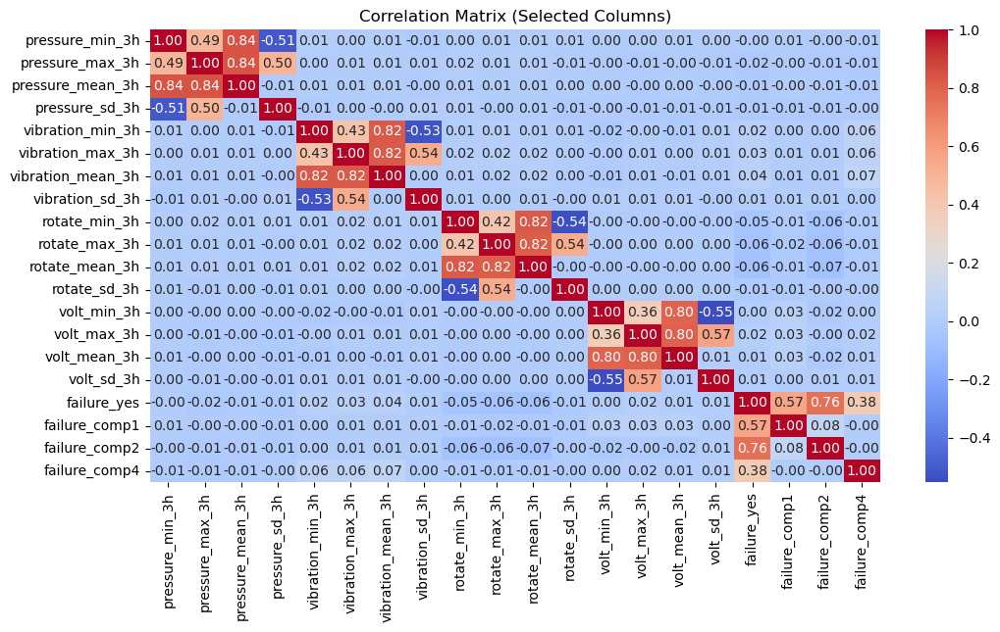

In [13]:
selected_columns = ['pressure_min_3h','pressure_max_3h','pressure_mean_3h','pressure_sd_3h',
                    'vibration_min_3h','vibration_max_3h','vibration_mean_3h','vibration_sd_3h',
                    'rotate_min_3h','rotate_max_3h','rotate_mean_3h','rotate_sd_3h',
                    'volt_min_3h','volt_max_3h','volt_mean_3h','volt_sd_3h',
                    'failure_yes','failure_comp1','failure_comp2','failure_comp4',
                   ]
selected_data = data_encoded[selected_columns]

# Korelasyon matrisini hesaplayalım
correlation_matrix = selected_data.corr()

# Korelasyon matrisini görselleştirelim
plt.figure(figsize=(12, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix (Selected Columns)')
plt.show()

polynomial fetures ve etkileşim özellikleri oluşturma mean ve sd ler üzerinden 3h 

In [14]:
from sklearn.preprocessing import PolynomialFeatures

# Özellikleri seçme
features = ['vibration_mean_3h', 'rotate_mean_3h', 'pressure_mean_3h', 'volt_mean_3h',
           ]

# Polynomial features oluşturma
poly = PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
poly_features = poly.fit_transform(data_en_fe[features])
poly_feature_names = poly.get_feature_names_out(features)

# Yeni özellikleri DataFrame'e ekleme
poly_df = pd.DataFrame(poly_features, columns=poly_feature_names, index=data_en_fe.index)
data_en_fe = pd.concat([data_en_fe, poly_df], axis=1)
data_en_fe.head(10)

,machineID,datetime,volt_min_3h,rotate_min_3h,pressure_min_3h,vibration_min_3h,volt_max_3h,rotate_max_3h,pressure_max_3h,vibration_max_3h,...,vibration_mean_3h,rotate_mean_3h,pressure_mean_3h,volt_mean_3h,vibration_mean_3h rotate_mean_3h,vibration_mean_3h pressure_mean_3h,vibration_mean_3h volt_mean_3h,rotate_mean_3h pressure_mean_3h,rotate_mean_3h volt_mean_3h,pressure_mean_3h volt_mean_3h
0,1,2015-01-02 06:00:00,158.271400,403.235951,92.439132,32.516838,200.872430,495.777958,96.535487,52.355876,...,41.551544,440.608320,94.137969,180.133784,18307.955836,3911.577947,7484.836785,41477.972599,79368.443961,16957.428664
1,1,2015-01-02 09:00:00,160.528861,384.645962,86.944273,29.527665,197.363124,486.459056,114.342061,42.992509,...,36.105580,439.349655,101.553209,176.364293,15862.974130,3666.637511,6367.735103,44617.367294,77485.591372,17910.359910
2,1,2015-01-02 12:00:00,147.300678,412.965696,90.711354,34.203042,173.394523,439.579460,110.408985,37.117103,...,36.094637,424.385316,99.598722,160.384568,15318.033927,3594.979719,5789.022762,42268.235084,68064.855482,15974.097993
3,1,2015-01-02 15:00:00,152.420775,385.354924,99.506819,30.665184,185.205355,497.840620,105.993247,47.862484,...,40.483002,442.933997,102.380586,170.472461,17931.297683,4144.673406,6901.236895,45347.841985,75508.048424,17453.070365
4,1,2015-01-02 18:00:00,145.248486,424.542633,93.743827,37.422272,180.030715,495.376449,111.950587,43.099758,...,40.921802,468.937558,102.726648,163.263806,19189.769738,4203.759507,6681.049070,48172.383439,76560.530404,16771.543483
5,1,2015-01-02 21:00:00,140.776309,414.274295,86.323760,31.279321,183.800863,493.161428,127.014498,45.135194,...,38.068116,446.493166,104.387585,163.278466,16997.153702,3973.838710,6215.703602,46608.343231,72902.719025,17044.244701
6,1,2015-01-03 00:00:00,160.656926,418.069791,80.668287,35.944564,190.927218,446.613843,115.313312,42.638679,...,39.716482,434.214692,93.747282,172.191198,17245.479778,3723.312191,6838.828539,40706.447152,74767.948057,16142.456812
7,1,2015-01-03 03:00:00,168.373525,489.910898,101.528033,35.468444,179.550116,521.837936,114.042406,41.730698,...,37.763933,504.845430,108.512153,175.210027,19064.948851,4097.845652,6616.619689,54781.864653,88453.981691,19012.417346
8,1,2015-01-03 06:00:00,174.138401,418.842271,91.926306,32.323616,194.942847,510.256976,95.896312,47.163648,...,38.621099,472.783187,93.395164,181.690108,18259.406484,3607.023898,7017.071734,44155.663144,85900.028539,16968.977389
9,1,2015-01-03 09:00:00,164.341435,459.956670,94.488533,47.875804,177.594089,568.972310,104.432962,52.997327,...,49.965572,505.141261,98.524373,172.382935,25239.671930,4922.826640,8613.211896,49768.726172,87077.733111,16983.920610


In [16]:
data_en_fe.to_csv('data_fe.csv', index=False)